In [1]:
import cv2
import numpy as np
import tensorflow as tf
import matplotlib.pyplot as plt
import os
os.environ['TF_CPP_MIN_LOG_LEVEL'] = '2'
import plotly.express as px


2023-01-31 14:39:59.296628: I tensorflow/core/platform/cpu_feature_guard.cc:193] This TensorFlow binary is optimized with oneAPI Deep Neural Network Library (oneDNN) to use the following CPU instructions in performance-critical operations:  SSE4.1 SSE4.2
To enable them in other operations, rebuild TensorFlow with the appropriate compiler flags.


In [3]:
modelLenet = tf.keras.models.load_model('/Users/harry.lopez/Documents/Python/Models/Test2.3.h5')
modelAlexNet = tf.keras.models.load_model('/Users/harry.lopez/Documents/Python/Models/Test.Alexnet.h5')
modelTest1 = tf.keras.models.load_model('/Users/harry.lopez/Documents/Python/Models/Test1.2.h5')
modelTest2 = tf.keras.models.load_model('/Users/harry.lopez/Documents/Python/Models/Test2.5.h5')
modelTest3 = tf.keras.models.load_model('/Users/harry.lopez/Documents/Python/Models/Test3.1.h5')
modelTest3_2 = tf.keras.models.load_model('/Users/harry.lopez/Documents/Python/Models/Test3.2.h5')
modelTest6 = tf.keras.models.load_model('/Users/harry.lopez/Documents/Python/Models/Test6.1.h5')

In [4]:
CLASS_LABELS = ['Abuse','Arrest','Arson','Assault','Burglary','Explosion','Fighting',"Normal",'RoadAccidents','Robbery','Shooting','Shoplifting','Stealing','Vandalism']
CLASS_LABELS2 = ['Anomalia','Normal']

PATH_IMAGE = "/Users/harry.lopez/Documents/Dataset/Test Video/Asalto.mp4"
#PATH_IMAGE = "/Users/harry.lopez/Documents/Dataset/Test Video/ExplosionesVideo.mp4"
#PATH_IMAGE = "/Users/harry.lopez/Documents/Dataset/Test Video/RoadAccidents.mp4"
PREDICTION_IMAGE = []
PREDICTION_TEXT = []
PREDICTION_VIDEO = []

In [5]:
import matplotlib.pyplot as plt
def display_images(img_list,title_list, cmap='gray', cols = 5, fig_size = (20, 20) ):
    """
    Display images in img_list
    """
    i = 1  # for subplot

    num_images = len(img_list)
    num_rows = 8

    plt.figure(figsize=fig_size)
    plt.subplots_adjust(top = 1.0)

    # BUcle de las imagenes a mostrar
    for image in img_list:
        if i < 40:
            image_file_name = title_list[i - 1]
            plt.subplot(num_rows, cols, i)        
            plt.title(image_file_name,fontsize=15,color="green", pad='2.0')
            plt.imshow(image, cmap=cmap)        
        i += 1     

    plt.show()

In [ ]:
display_images(PREDICTION_IMAGE,PREDICTION_TEXT)

In [6]:
def validateModel(pathImage, modelFunc, 
                  nameModel, classes):
    
    cap = cv2.VideoCapture(pathImage)
    ret, frame = cap.read()
    count = 0
    predictionIds = []
    countFrames = 0;
    frameArray = []
    predictionFrame = []

    # Mientras haya fotogramas
    while ret:
        # Redimensiona el fotograma a las dimensiones de entrada del modelo
        frame = cv2.resize(frame, (64, 64))

        # Convierte el fotograma a un tensor de una sola dimensión
        input_data = np.expand_dims(frame, axis=0)

        # Hace una predicción sobre el fotograma
        prediction = modelFunc.predict(input_data, 
                                       verbose = 0)

        #Obtiene el index de la mayor predicción del modelo
        index = indices = np.where(prediction[0] == prediction[0].max())
        predictionIds.append(index)
        

        #Cada 50 frames se obtiene una imagen
        if countFrames == 50:
            predictionFrame.append(classes[index[0][0]] 
                                   + '=Frame:' + str(count))
            frameArray.append(frame)
            countFrames = 0
        else:
            countFrames += 1
        ret, frame = cap.read()
        count += 1


    # Libera el video
    print("Cantidad de Fotogramas:", count)
    print("Modelo de Prueba:", nameModel)
    cap.release()
    display_images(frameArray,predictionFrame)

In [22]:
def validateModelVideo(pathImage, modelFunc, nameModel, classes, width, height):
    #cap = cv2.VideoCapture('/Users/harry.lopez/Documents/Dataset/Dataset/Vandalism/Vandalism033_x264.mp4')
    cap = cv2.VideoCapture(pathImage)
    
    count = 0
    predictionIds = []
    countFrames = 0;
    frameArray = []
    predictionFrame = []

    # Mientras haya fotogramas
    while (cap.isOpened()):
        
        ret, frame = cap.read()
        # Redimensiona el fotograma a las dimensiones de entrada del modelo
        frame2 = cv2.resize(frame, (width, height))
        
        frame = cv2.resize(frame, (64, 64))

        # Convierte el fotograma a un tensor de una sola dimensión
        input_data = np.expand_dims(frame, axis=0)

        # Hace una predicción sobre el fotograma
        prediction = modelFunc.predict(input_data, verbose = 0)

        #print('Prediction:', prediction)
        index = indices = np.where(prediction[0] == prediction[0].max())
        predictionIds.append(index)
        #print('index', CLASS_LABELS[index[0][0]])
        
        scores = np.argsort(prediction[0])[::-1][:3]
        
        predictionString = classes[scores[0]]
        predictionString1 = classes[scores[1]]
        predictionString2 = classes[scores[2]]
        
        cv2.putText(frame2, predictionString, (45,45), cv2.FONT_HERSHEY_TRIPLEX, 2.0, (0,0,255), 1)
        cv2.putText(frame2, predictionString1, (45,100), cv2.FONT_HERSHEY_TRIPLEX, 2.0, (0,0,255), 1)
        cv2.putText(frame2, predictionString2, (45,155), cv2.FONT_HERSHEY_TRIPLEX, 2.0, (0,0,255), 1)
        
        PREDICTION_VIDEO.append(scores)
        count += 1
        cv2.imshow('Capture', frame2)


    # Libera el video
    print("Cantidad de Fotogramas:", count)
    print("Modelo de Prueba:", nameModel)
    cap.release()
    display_images(frameArray,predictionFrame)

[ WARN:0@421421.624] global /private/var/folders/sy/f16zz6x50xz3113nwtb9bvq00000gp/T/abs_506zufg7xt/croots/recipe/opencv-suite_1664548331847/work/modules/videoio/src/cap_gstreamer.cpp (862) isPipelinePlaying OpenCV | GStreamer warning: GStreamer: pipeline have not been created
[ERROR:0@421421.624] global /private/var/folders/sy/f16zz6x50xz3113nwtb9bvq00000gp/T/abs_506zufg7xt/croots/recipe/opencv-suite_1664548331847/work/modules/videoio/src/cap.cpp (166) open VIDEOIO(GSTREAMER): raised OpenCV exception:

OpenCV(4.6.0) /private/var/folders/sy/f16zz6x50xz3113nwtb9bvq00000gp/T/abs_506zufg7xt/croots/recipe/opencv-suite_1664548331847/work/modules/core/src/utils/filesystem.cpp:580: error: (-213:The function/feature is not implemented)  in function 'exists'




Cantidad de Fotogramas: 8228
Modelo de Prueba: Model letnet


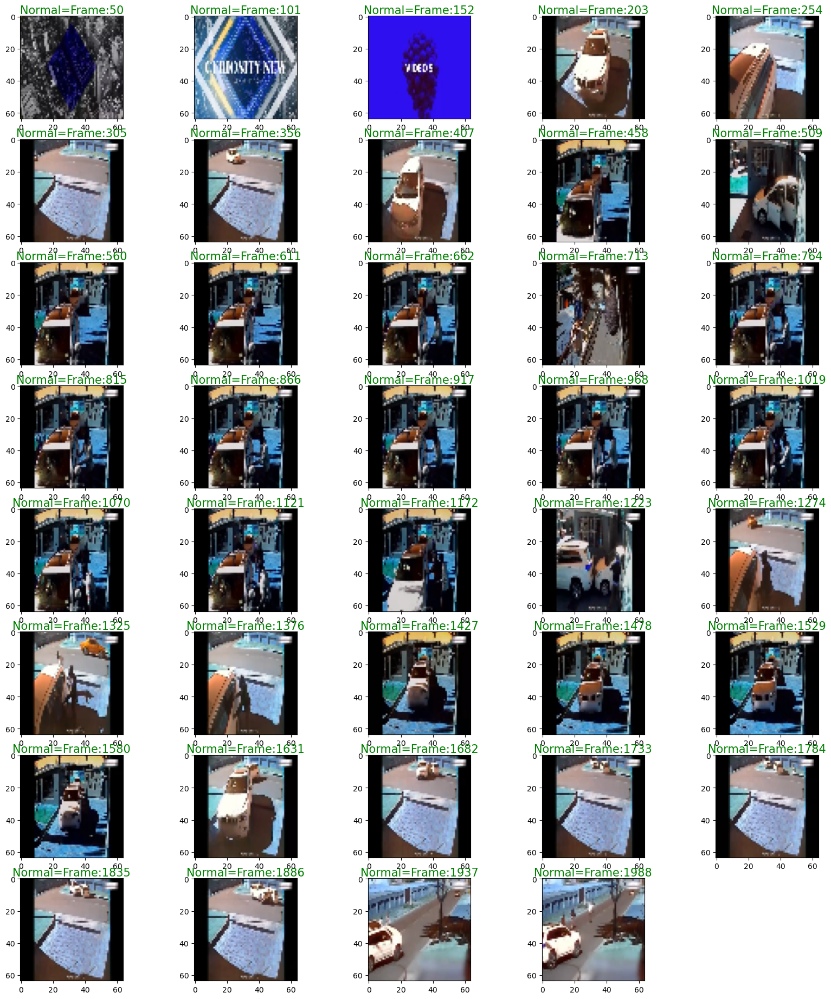

In [212]:
#Test LetNet
validateModel(PATH_IMAGE, modelLenet, 'Model letnet', CLASS_LABELS)

[ WARN:0@421863.514] global /private/var/folders/sy/f16zz6x50xz3113nwtb9bvq00000gp/T/abs_506zufg7xt/croots/recipe/opencv-suite_1664548331847/work/modules/videoio/src/cap_gstreamer.cpp (862) isPipelinePlaying OpenCV | GStreamer warning: GStreamer: pipeline have not been created
[ERROR:0@421863.515] global /private/var/folders/sy/f16zz6x50xz3113nwtb9bvq00000gp/T/abs_506zufg7xt/croots/recipe/opencv-suite_1664548331847/work/modules/videoio/src/cap.cpp (166) open VIDEOIO(GSTREAMER): raised OpenCV exception:

OpenCV(4.6.0) /private/var/folders/sy/f16zz6x50xz3113nwtb9bvq00000gp/T/abs_506zufg7xt/croots/recipe/opencv-suite_1664548331847/work/modules/core/src/utils/filesystem.cpp:580: error: (-213:The function/feature is not implemented)  in function 'exists'




Cantidad de Fotogramas: 8228
Modelo de Prueba: Model Alexnet


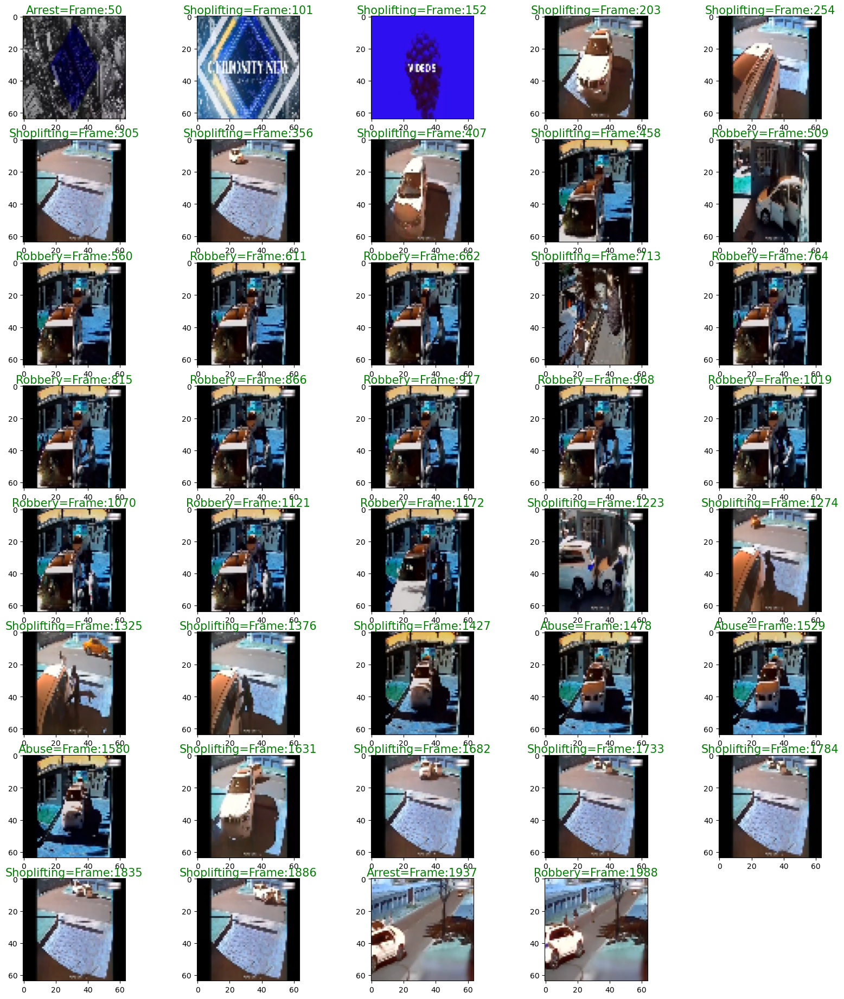

In [213]:
validateModel(PATH_IMAGE, modelAlexNet, 'Model Alexnet', CLASS_LABELS)

[ WARN:0@422935.359] global /private/var/folders/sy/f16zz6x50xz3113nwtb9bvq00000gp/T/abs_506zufg7xt/croots/recipe/opencv-suite_1664548331847/work/modules/videoio/src/cap_gstreamer.cpp (862) isPipelinePlaying OpenCV | GStreamer warning: GStreamer: pipeline have not been created
[ERROR:0@422935.359] global /private/var/folders/sy/f16zz6x50xz3113nwtb9bvq00000gp/T/abs_506zufg7xt/croots/recipe/opencv-suite_1664548331847/work/modules/videoio/src/cap.cpp (166) open VIDEOIO(GSTREAMER): raised OpenCV exception:

OpenCV(4.6.0) /private/var/folders/sy/f16zz6x50xz3113nwtb9bvq00000gp/T/abs_506zufg7xt/croots/recipe/opencv-suite_1664548331847/work/modules/core/src/utils/filesystem.cpp:580: error: (-213:The function/feature is not implemented)  in function 'exists'




Cantidad de Fotogramas: 5267
Modelo de Prueba: Model Test 1


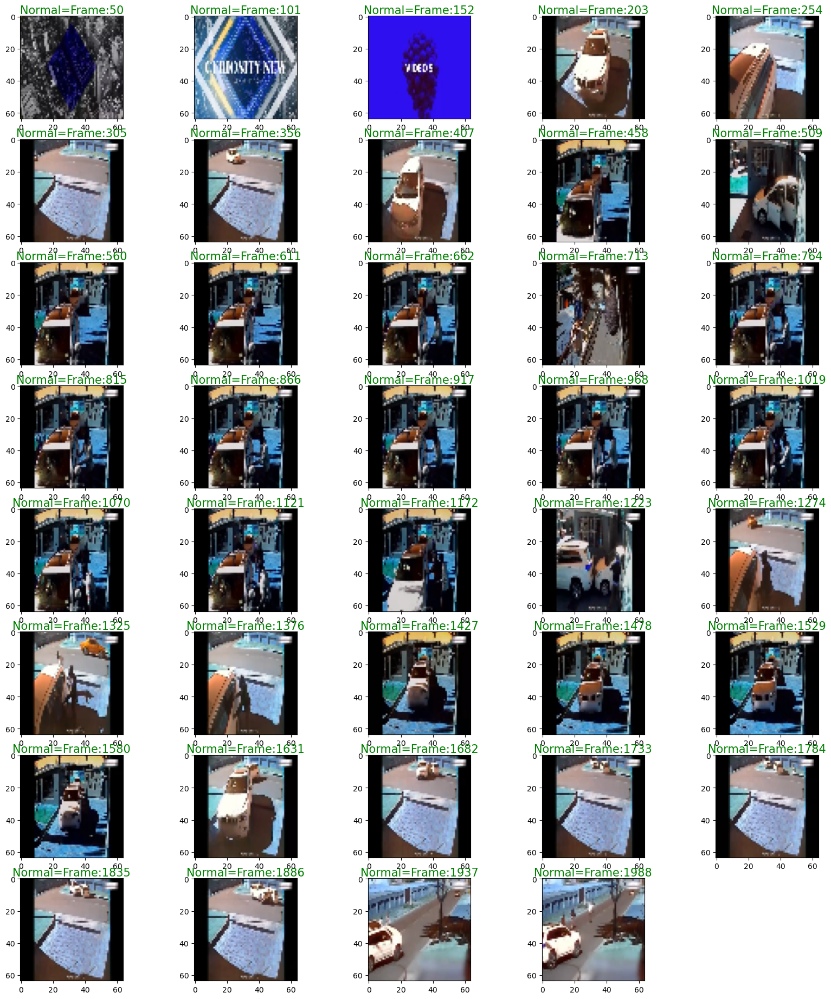

In [214]:
validateModel(PATH_IMAGE, modelTest1, 'Model Test 1', CLASS_LABELS)

[ WARN:0@442874.504] global /private/var/folders/sy/f16zz6x50xz3113nwtb9bvq00000gp/T/abs_506zufg7xt/croots/recipe/opencv-suite_1664548331847/work/modules/videoio/src/cap_gstreamer.cpp (862) isPipelinePlaying OpenCV | GStreamer warning: GStreamer: pipeline have not been created
[ERROR:0@442874.505] global /private/var/folders/sy/f16zz6x50xz3113nwtb9bvq00000gp/T/abs_506zufg7xt/croots/recipe/opencv-suite_1664548331847/work/modules/videoio/src/cap.cpp (166) open VIDEOIO(GSTREAMER): raised OpenCV exception:

OpenCV(4.6.0) /private/var/folders/sy/f16zz6x50xz3113nwtb9bvq00000gp/T/abs_506zufg7xt/croots/recipe/opencv-suite_1664548331847/work/modules/core/src/utils/filesystem.cpp:580: error: (-213:The function/feature is not implemented)  in function 'exists'




Cantidad de Fotogramas: 8228
Modelo de Prueba: Model Test 2


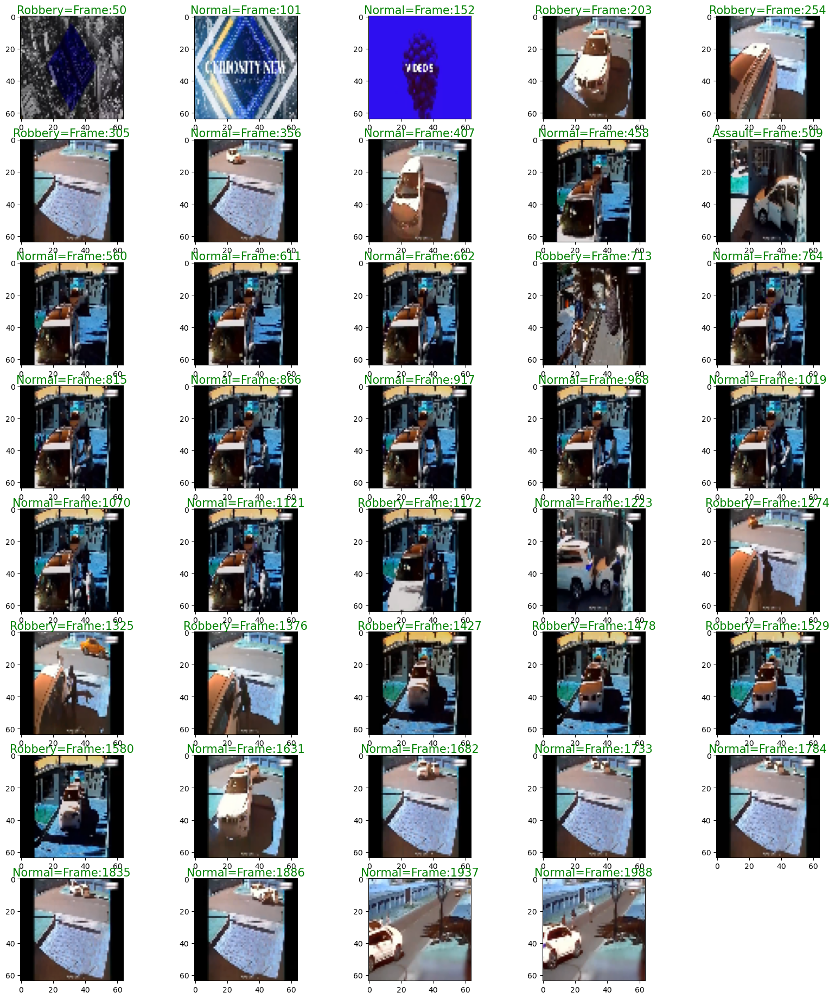

In [219]:
validateModel(PATH_IMAGE, modelTest2, 'Model Test 2', CLASS_LABELS)

[ WARN:0@487162.168] global /private/var/folders/sy/f16zz6x50xz3113nwtb9bvq00000gp/T/abs_506zufg7xt/croots/recipe/opencv-suite_1664548331847/work/modules/videoio/src/cap_gstreamer.cpp (862) isPipelinePlaying OpenCV | GStreamer warning: GStreamer: pipeline have not been created
[ERROR:0@487162.169] global /private/var/folders/sy/f16zz6x50xz3113nwtb9bvq00000gp/T/abs_506zufg7xt/croots/recipe/opencv-suite_1664548331847/work/modules/videoio/src/cap.cpp (166) open VIDEOIO(GSTREAMER): raised OpenCV exception:

OpenCV(4.6.0) /private/var/folders/sy/f16zz6x50xz3113nwtb9bvq00000gp/T/abs_506zufg7xt/croots/recipe/opencv-suite_1664548331847/work/modules/core/src/utils/filesystem.cpp:580: error: (-213:The function/feature is not implemented)  in function 'exists'




Cantidad de Fotogramas: 8228
Modelo de Prueba: Model Test 2


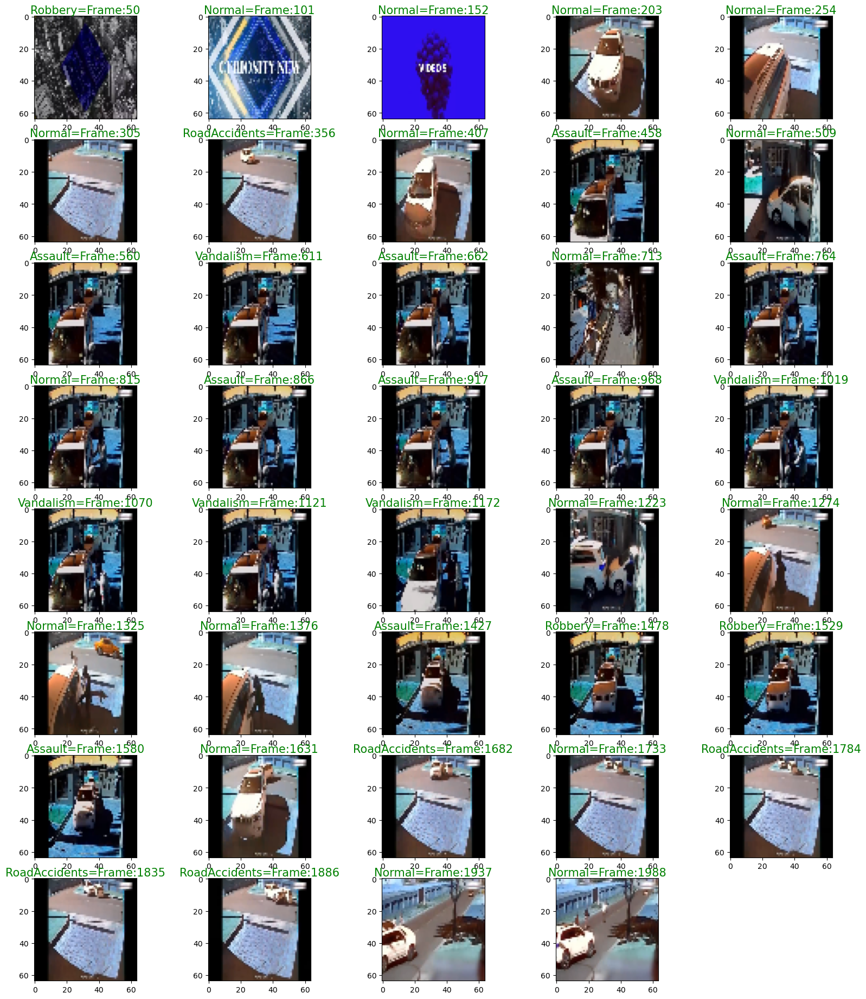

In [221]:
validateModel(PATH_IMAGE, modelTest2, 'Model Test 2', CLASS_LABELS)

[ WARN:0@106.216] global /private/var/folders/sy/f16zz6x50xz3113nwtb9bvq00000gp/T/abs_506zufg7xt/croots/recipe/opencv-suite_1664548331847/work/modules/videoio/src/cap_gstreamer.cpp (862) isPipelinePlaying OpenCV | GStreamer warning: GStreamer: pipeline have not been created
[ERROR:0@106.217] global /private/var/folders/sy/f16zz6x50xz3113nwtb9bvq00000gp/T/abs_506zufg7xt/croots/recipe/opencv-suite_1664548331847/work/modules/videoio/src/cap.cpp (166) open VIDEOIO(GSTREAMER): raised OpenCV exception:

OpenCV(4.6.0) /private/var/folders/sy/f16zz6x50xz3113nwtb9bvq00000gp/T/abs_506zufg7xt/croots/recipe/opencv-suite_1664548331847/work/modules/core/src/utils/filesystem.cpp:580: error: (-213:The function/feature is not implemented)  in function 'exists'




Cantidad de Fotogramas: 8228
Modelo de Prueba: Model Test 6


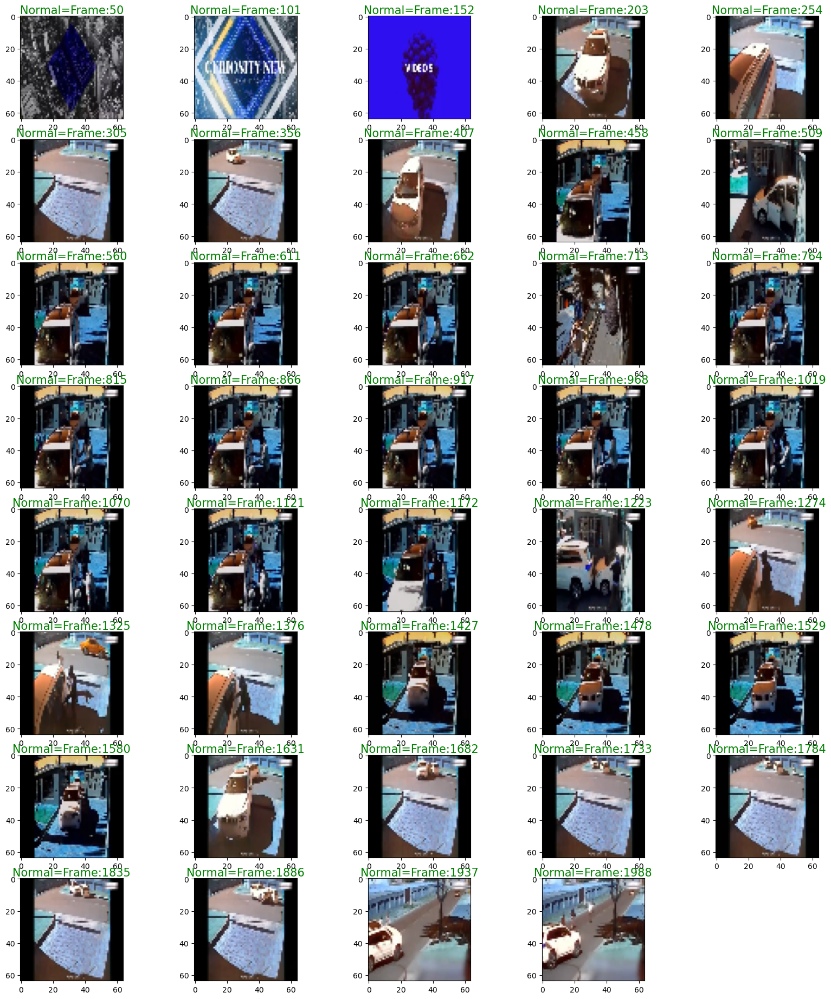

In [6]:
validateModel(PATH_IMAGE, modelTest6, 'Model Test 6', CLASS_LABELS2)

[ WARN:0@191.002] global /private/var/folders/sy/f16zz6x50xz3113nwtb9bvq00000gp/T/abs_506zufg7xt/croots/recipe/opencv-suite_1664548331847/work/modules/videoio/src/cap_gstreamer.cpp (862) isPipelinePlaying OpenCV | GStreamer warning: GStreamer: pipeline have not been created
[ERROR:0@191.002] global /private/var/folders/sy/f16zz6x50xz3113nwtb9bvq00000gp/T/abs_506zufg7xt/croots/recipe/opencv-suite_1664548331847/work/modules/videoio/src/cap.cpp (166) open VIDEOIO(GSTREAMER): raised OpenCV exception:

OpenCV(4.6.0) /private/var/folders/sy/f16zz6x50xz3113nwtb9bvq00000gp/T/abs_506zufg7xt/croots/recipe/opencv-suite_1664548331847/work/modules/core/src/utils/filesystem.cpp:580: error: (-213:The function/feature is not implemented)  in function 'exists'




Cantidad de Fotogramas: 8228
Modelo de Prueba: Model Test 3


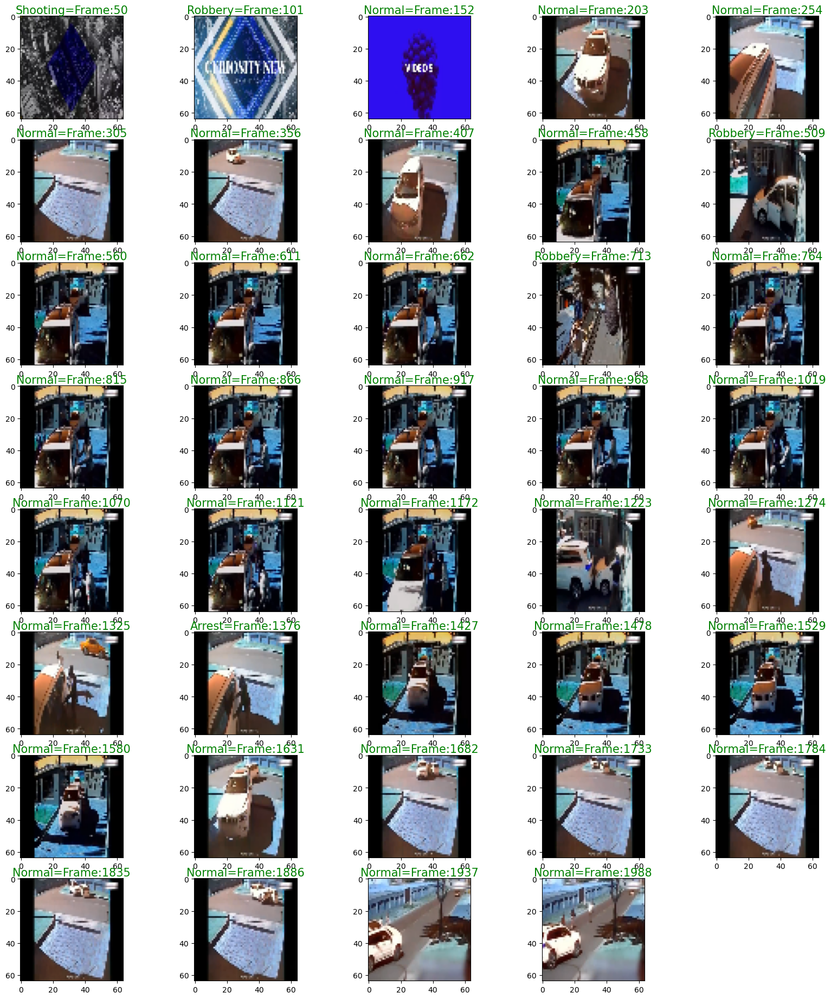

In [7]:
validateModel(PATH_IMAGE, modelTest3, 'Model Test 3', CLASS_LABELS)

[ WARN:0@66533.683] global /private/var/folders/sy/f16zz6x50xz3113nwtb9bvq00000gp/T/abs_506zufg7xt/croots/recipe/opencv-suite_1664548331847/work/modules/videoio/src/cap_gstreamer.cpp (862) isPipelinePlaying OpenCV | GStreamer warning: GStreamer: pipeline have not been created
[ERROR:0@66533.683] global /private/var/folders/sy/f16zz6x50xz3113nwtb9bvq00000gp/T/abs_506zufg7xt/croots/recipe/opencv-suite_1664548331847/work/modules/videoio/src/cap.cpp (166) open VIDEOIO(GSTREAMER): raised OpenCV exception:

OpenCV(4.6.0) /private/var/folders/sy/f16zz6x50xz3113nwtb9bvq00000gp/T/abs_506zufg7xt/croots/recipe/opencv-suite_1664548331847/work/modules/core/src/utils/filesystem.cpp:580: error: (-213:The function/feature is not implemented)  in function 'exists'




Cantidad de Fotogramas: 8228
Modelo de Prueba: Model Test 3-2


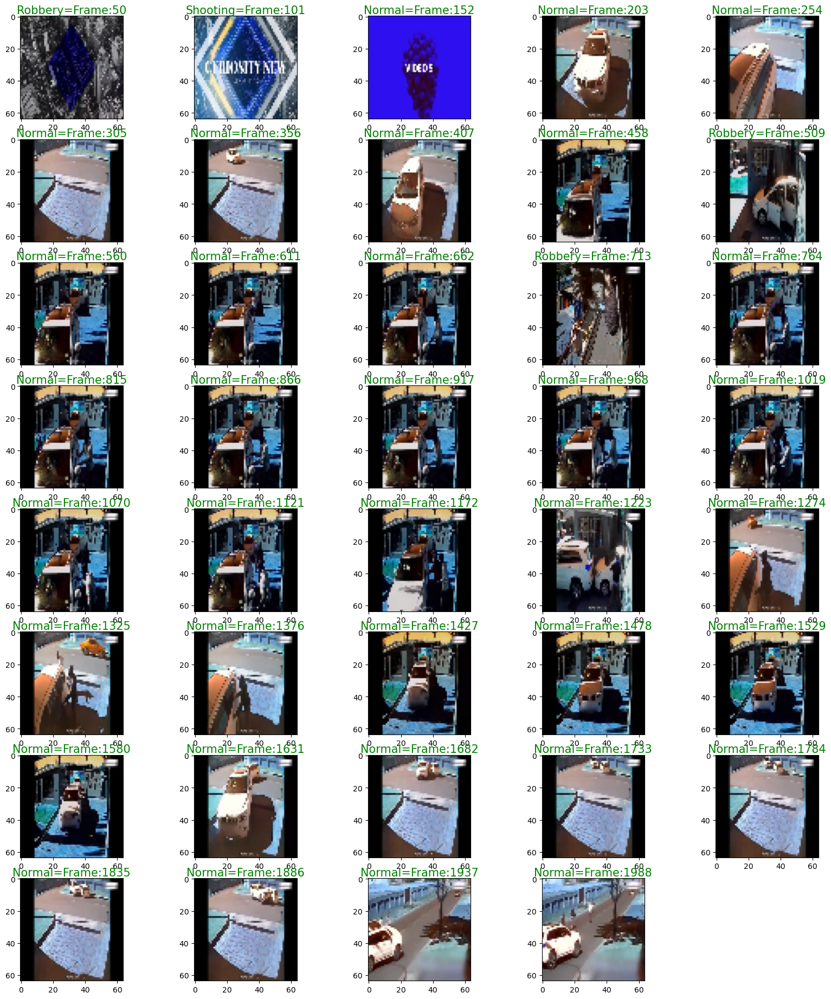

In [9]:
validateModel(PATH_IMAGE, modelTest3_2, 'Model Test 3-2', CLASS_LABELS)

[ WARN:0@69306.830] global /private/var/folders/sy/f16zz6x50xz3113nwtb9bvq00000gp/T/abs_506zufg7xt/croots/recipe/opencv-suite_1664548331847/work/modules/videoio/src/cap_gstreamer.cpp (862) isPipelinePlaying OpenCV | GStreamer warning: GStreamer: pipeline have not been created
[ERROR:0@69306.831] global /private/var/folders/sy/f16zz6x50xz3113nwtb9bvq00000gp/T/abs_506zufg7xt/croots/recipe/opencv-suite_1664548331847/work/modules/videoio/src/cap.cpp (166) open VIDEOIO(GSTREAMER): raised OpenCV exception:

OpenCV(4.6.0) /private/var/folders/sy/f16zz6x50xz3113nwtb9bvq00000gp/T/abs_506zufg7xt/croots/recipe/opencv-suite_1664548331847/work/modules/core/src/utils/filesystem.cpp:580: error: (-213:The function/feature is not implemented)  in function 'exists'




Cantidad de Fotogramas: 20972
Modelo de Prueba: Model Test 3-2-2


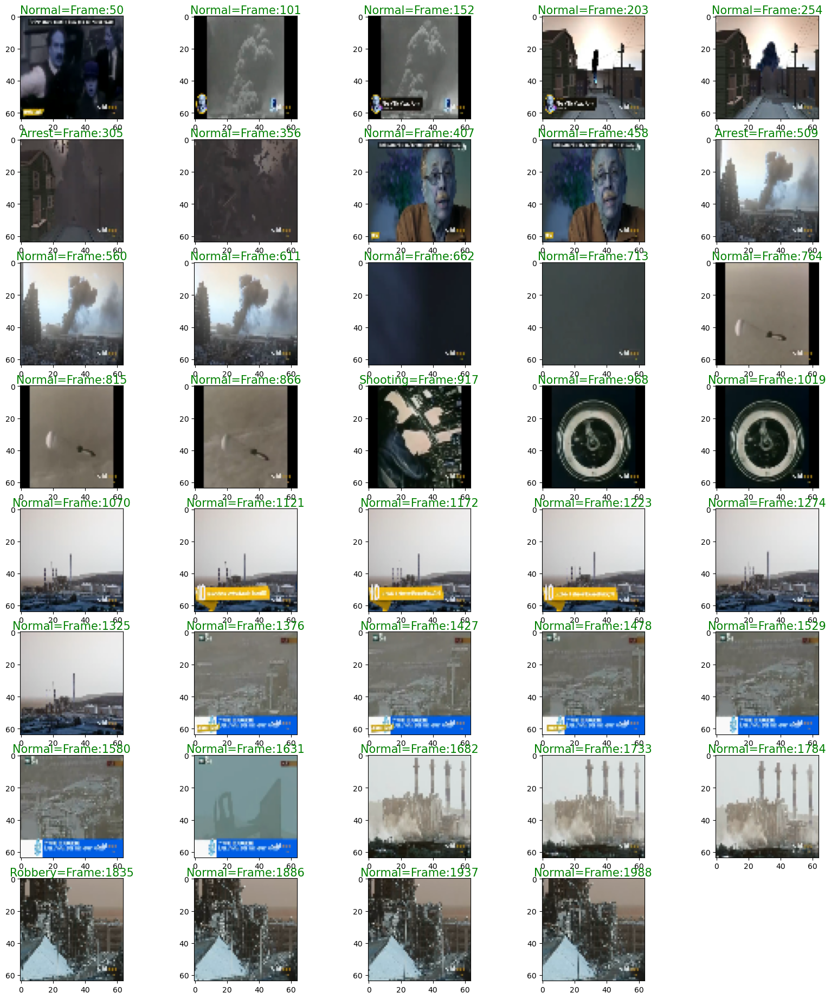

In [11]:
validateModel(PATH_IMAGE, modelTest3_2, 'Model Test 3-2-2', CLASS_LABELS)

[ WARN:0@70460.927] global /private/var/folders/sy/f16zz6x50xz3113nwtb9bvq00000gp/T/abs_506zufg7xt/croots/recipe/opencv-suite_1664548331847/work/modules/videoio/src/cap_gstreamer.cpp (862) isPipelinePlaying OpenCV | GStreamer warning: GStreamer: pipeline have not been created
[ERROR:0@70460.927] global /private/var/folders/sy/f16zz6x50xz3113nwtb9bvq00000gp/T/abs_506zufg7xt/croots/recipe/opencv-suite_1664548331847/work/modules/videoio/src/cap.cpp (166) open VIDEOIO(GSTREAMER): raised OpenCV exception:

OpenCV(4.6.0) /private/var/folders/sy/f16zz6x50xz3113nwtb9bvq00000gp/T/abs_506zufg7xt/croots/recipe/opencv-suite_1664548331847/work/modules/core/src/utils/filesystem.cpp:580: error: (-213:The function/feature is not implemented)  in function 'exists'




Cantidad de Fotogramas: 20972
Modelo de Prueba: Model Alexnet-2


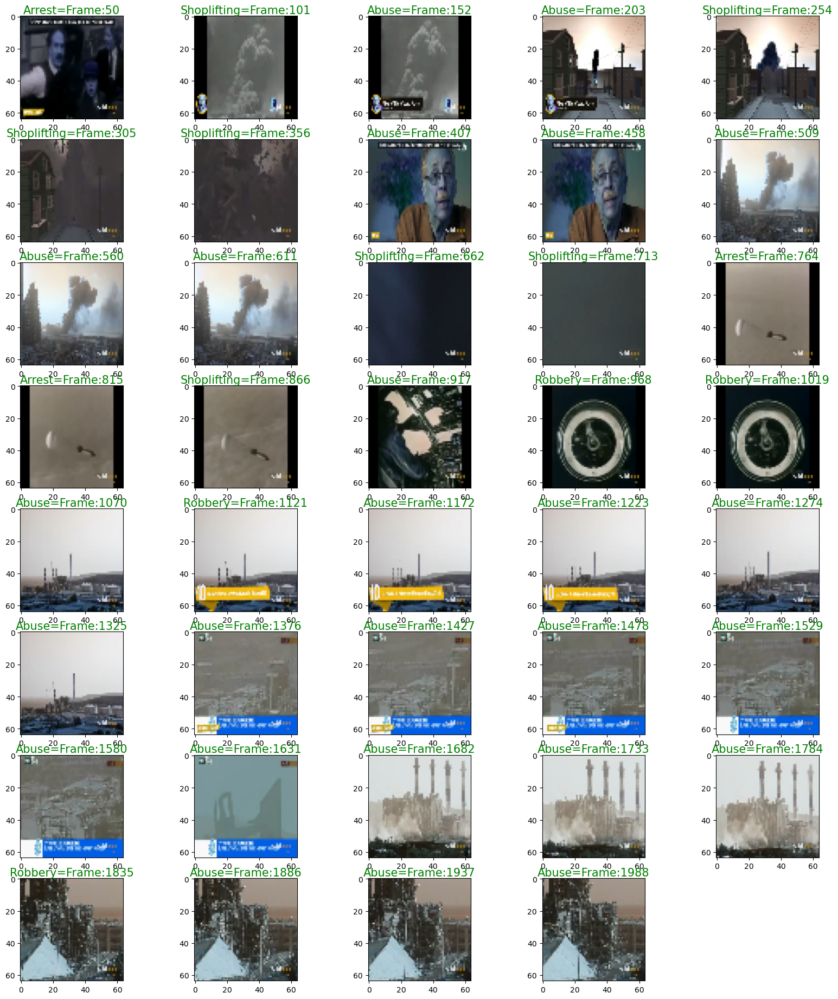

In [12]:
validateModel(PATH_IMAGE, modelAlexNet, 'Model Alexnet-2', CLASS_LABELS)

[ WARN:0@72831.929] global /private/var/folders/sy/f16zz6x50xz3113nwtb9bvq00000gp/T/abs_506zufg7xt/croots/recipe/opencv-suite_1664548331847/work/modules/videoio/src/cap_gstreamer.cpp (862) isPipelinePlaying OpenCV | GStreamer warning: GStreamer: pipeline have not been created
[ERROR:0@72831.930] global /private/var/folders/sy/f16zz6x50xz3113nwtb9bvq00000gp/T/abs_506zufg7xt/croots/recipe/opencv-suite_1664548331847/work/modules/videoio/src/cap.cpp (166) open VIDEOIO(GSTREAMER): raised OpenCV exception:

OpenCV(4.6.0) /private/var/folders/sy/f16zz6x50xz3113nwtb9bvq00000gp/T/abs_506zufg7xt/croots/recipe/opencv-suite_1664548331847/work/modules/core/src/utils/filesystem.cpp:580: error: (-213:The function/feature is not implemented)  in function 'exists'




Cantidad de Fotogramas: 16316
Modelo de Prueba: Model Test 3-2-3


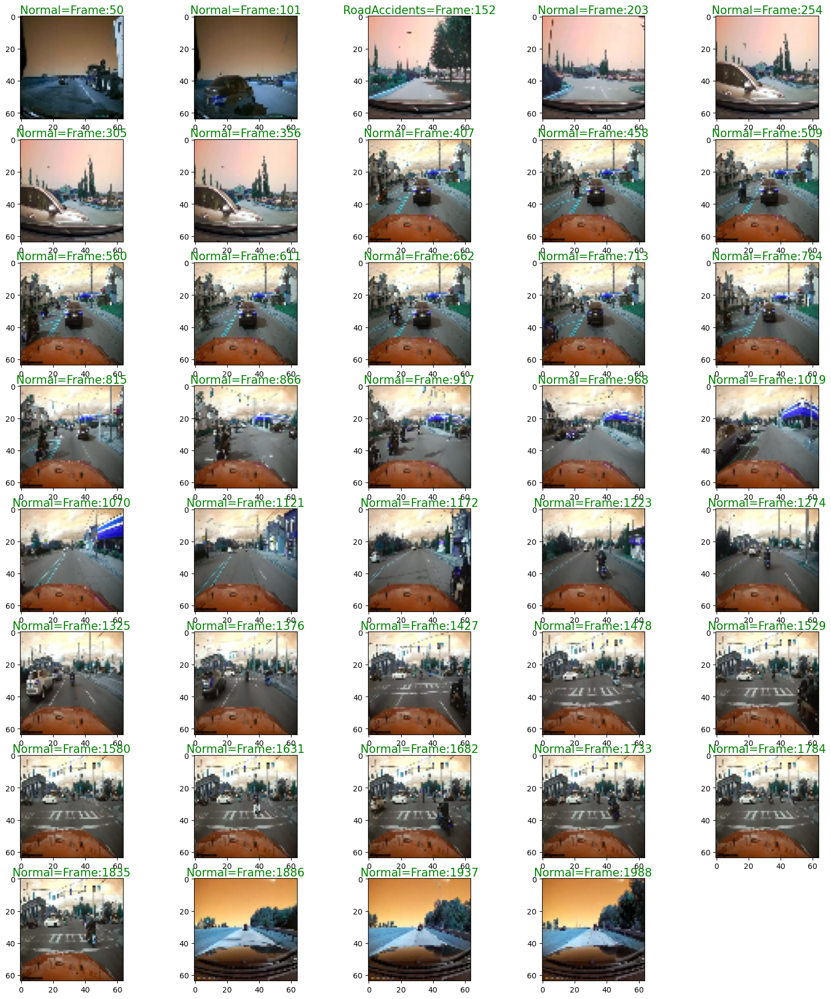

In [14]:
validateModel(PATH_IMAGE, modelTest3_2, 'Model Test 3-2-3', CLASS_LABELS)

[ WARN:0@73637.127] global /private/var/folders/sy/f16zz6x50xz3113nwtb9bvq00000gp/T/abs_506zufg7xt/croots/recipe/opencv-suite_1664548331847/work/modules/videoio/src/cap_gstreamer.cpp (862) isPipelinePlaying OpenCV | GStreamer warning: GStreamer: pipeline have not been created
[ERROR:0@73637.127] global /private/var/folders/sy/f16zz6x50xz3113nwtb9bvq00000gp/T/abs_506zufg7xt/croots/recipe/opencv-suite_1664548331847/work/modules/videoio/src/cap.cpp (166) open VIDEOIO(GSTREAMER): raised OpenCV exception:

OpenCV(4.6.0) /private/var/folders/sy/f16zz6x50xz3113nwtb9bvq00000gp/T/abs_506zufg7xt/croots/recipe/opencv-suite_1664548331847/work/modules/core/src/utils/filesystem.cpp:580: error: (-213:The function/feature is not implemented)  in function 'exists'




Cantidad de Fotogramas: 16316
Modelo de Prueba: Model Alexnet-3


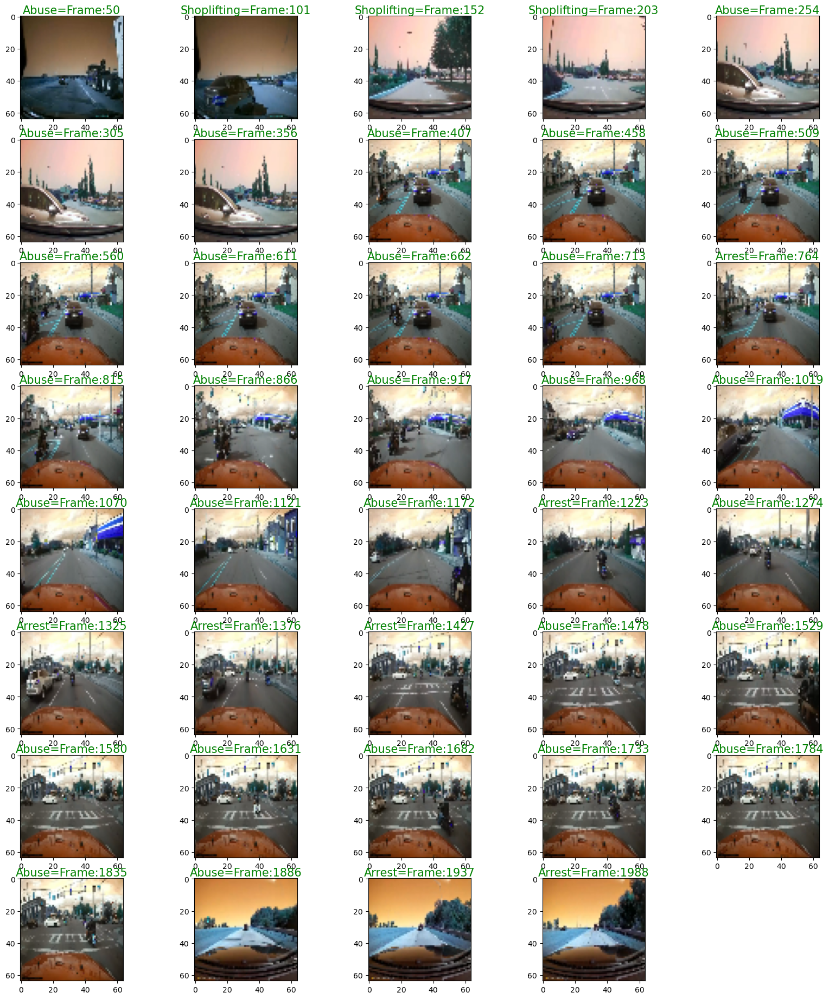

In [15]:
validateModel(PATH_IMAGE, modelAlexNet, 'Model Alexnet-3', CLASS_LABELS)

[ WARN:0@75835.465] global /private/var/folders/sy/f16zz6x50xz3113nwtb9bvq00000gp/T/abs_506zufg7xt/croots/recipe/opencv-suite_1664548331847/work/modules/videoio/src/cap_gstreamer.cpp (862) isPipelinePlaying OpenCV | GStreamer warning: GStreamer: pipeline have not been created
[ERROR:0@75835.465] global /private/var/folders/sy/f16zz6x50xz3113nwtb9bvq00000gp/T/abs_506zufg7xt/croots/recipe/opencv-suite_1664548331847/work/modules/videoio/src/cap.cpp (166) open VIDEOIO(GSTREAMER): raised OpenCV exception:

OpenCV(4.6.0) /private/var/folders/sy/f16zz6x50xz3113nwtb9bvq00000gp/T/abs_506zufg7xt/croots/recipe/opencv-suite_1664548331847/work/modules/core/src/utils/filesystem.cpp:580: error: (-213:The function/feature is not implemented)  in function 'exists'




Cantidad de Fotogramas: 16316
Modelo de Prueba: Model Test 2-2


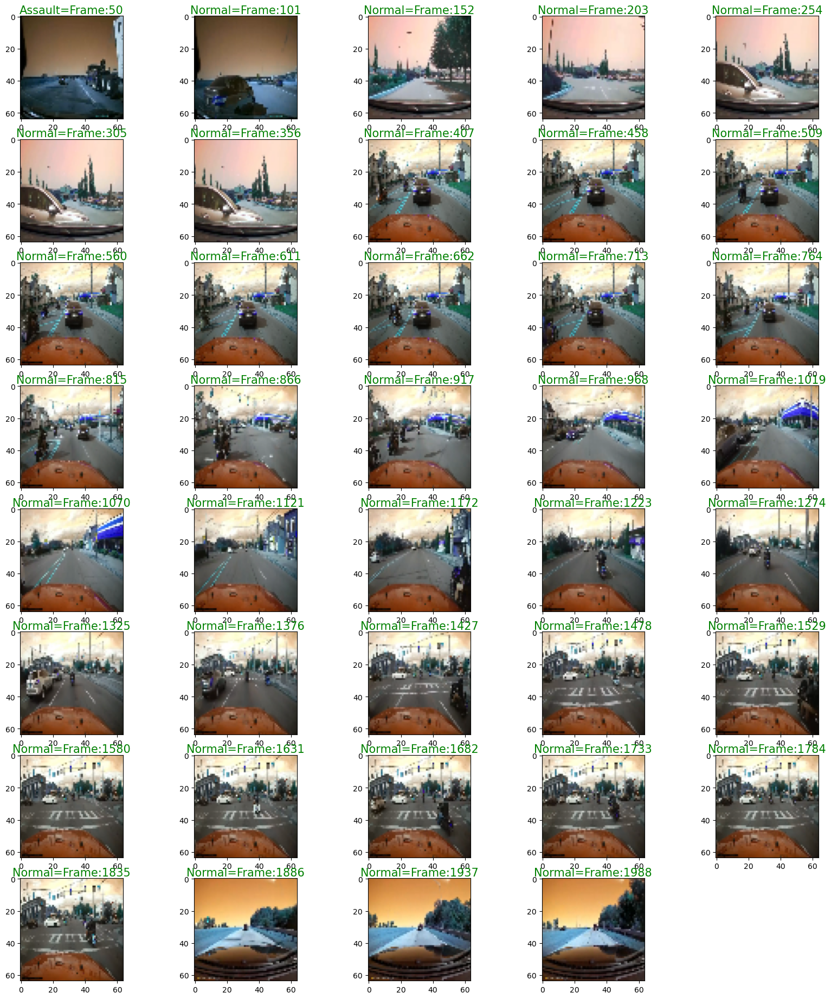

In [16]:
validateModel(PATH_IMAGE, modelTest2, 'Model Test 2-2', CLASS_LABELS)

In [ ]:
validateModelVideo(PATH_IMAGE, modelTest3_2, 'Model Test 3-2-3', CLASS_LABELS, 1024, 768)

[ WARN:0@157092.145] global /private/var/folders/sy/f16zz6x50xz3113nwtb9bvq00000gp/T/abs_506zufg7xt/croots/recipe/opencv-suite_1664548331847/work/modules/videoio/src/cap_gstreamer.cpp (862) isPipelinePlaying OpenCV | GStreamer warning: GStreamer: pipeline have not been created
[ERROR:0@157092.145] global /private/var/folders/sy/f16zz6x50xz3113nwtb9bvq00000gp/T/abs_506zufg7xt/croots/recipe/opencv-suite_1664548331847/work/modules/videoio/src/cap.cpp (166) open VIDEOIO(GSTREAMER): raised OpenCV exception:

OpenCV(4.6.0) /private/var/folders/sy/f16zz6x50xz3113nwtb9bvq00000gp/T/abs_506zufg7xt/croots/recipe/opencv-suite_1664548331847/work/modules/core/src/utils/filesystem.cpp:580: error: (-213:The function/feature is not implemented)  in function 'exists'




In [ ]:
validateModel(PATH_IMAGE, modelTest2, 'Model Test 2', CLASS_LABELS)